# Geospatial data processing and visualization

- **Instructor: Minsu Jang**, Postdoc @Behave Lab
- University of Milan, Computational Social Science Workshop

# Today, we're going to cover...

1. Understanding **`Conda`, `Virtual Environments`, and `YAML` Files**. 
2. Understanding **geospatial data and its handling in `Python`**.
3. **Topic Modeling** and its visualization on an *interactive map*.

## What is `Conda`?

- A **package manager** for Python and other languages.
- Comes with **Anaconda** or **Miniconda** distributions.
- Helps install, update, and manage packages and environments.
- Supports **binary package management** for useful libraries like `NumPy`, `Pandas`, etc.

***Example***: on your `terminal`(mac) or `anaconda prompt`(windows)
```bash
conda install numpy
```

## What is a Virtual Environment?

- A **self-contained directory** with its own Python interpreter and libraries.
- Keeps your project **isolated** from system-wide packages.
- Prevents version conflicts across projects.

### Why use one?
- Project A: `Python 3.8, Scikit-learn 1.3, Jupyter Notebook 6.5`
- Project B: `Python 3.13, Scikit-learn 1.6, Jupyter Notebook 7.2`
- Different needs? No problem!

## Creating a Virtual Environment with Conda

```bash
# Create an environment named "css-python"
conda create -n css-python python=3.9

# Activate it
conda activate css-python
```

You can now install packages only for this project!

## What is a YAML File?

A **YAML** file is a plain-text file to define environments:
- Packages
- Python version
- pip dependencies

Used to **reproduce environments** exactly.


In Our `css-python-geo.yml` file, we have..

```yaml
name: css-python-geo
channels:
  - conda-forge
  - defaults
dependencies:
  - python=3.9
  - jupyterlab
  - ipywidgets
  - pandas
  - scikit-learn
  - matplotlib
  - plotly
  - geopandas
  - folium
  - openpyxl
  - pyproj
  - shapely
  - requests
  - transformers
  - tqdm
  - seaborn
  - pyzmq
  - swifter
  - pytorch>=2.0
  - pip
  - pip:
      - sentence-transformers
      - bertopic
      - gensim
      - streamlit
      - streamlit-folium
      - langdetect
      - google-cloud-translate
```

To run it on terminal... 

```bash
# Create an environment from css-python-geo.yml
conda env create -f css-python-geo.yml

# Activate it
conda activate css-python-geo
```

## What is Geospatial Data?

- **Geospatial data** describes objects, events, or features with a location on Earth.
- Includes information about **coordinates**, **geometry**, and **attributes**.

### Examples:
- Location of Airbnb listings (lat/lon)
- Boundaries of Milan neighborhoods
- Roads, rivers, buildings

## Types of Geospatial Data

1. **Vector Data** (Discrete)
    1. Points (e.g., restaurant location)
    2. Lines (e.g., roads/routes)
    3. Polygons (e.g., boundaries)
    4. Common File Formats for Vector Data:
        - Shapefile (`.shp`)
    	- GeoJSON (`.geojson`, `.json`)
    	- KML (`.kml`)
    
2. **Raster Data** (Continuous, `.tif, .img, .asc, etc.`)

Today, we will mostly work with **vector data** with **GeoJSON** in this workshop.

## GeoJSON in Python

- **GeoJSON** is a common format for encoding vector geometries.
- Python's `geopandas` makes it easy to work with.
  
## What is a GeoDataFrame?
- Like a `pandas` DataFrame, but with a `geometry` column
- Used to store and manipulate spatial data in `geopandas`

### Example:

In [1]:
import geopandas as gpd

# Load a GeoJSON file
gdf = gpd.read_file("data/neighbourhoods.geojson")

# Preview the data
gdf.head()

,neighbourhood,neighbourhood_group,geometry
0,SACCO,None,"MULTIPOLYGON (((9.12195 45.51602, 9.12163 45.5..."
1,COMASINA,None,"MULTIPOLYGON (((9.16887 45.52396, 9.16804 45.5..."
2,STEPHENSON,None,"MULTIPOLYGON (((9.12932 45.50998, 9.12973 45.5..."
3,QT 8,None,"MULTIPOLYGON (((9.14368 45.48474, 9.14338 45.4..."
4,ORTOMERCATO,None,"MULTIPOLYGON (((9.23739 45.45588, 9.23731 45.4..."


## Accessing Geometry and Attributes

In [2]:
# Access geometry (polygons)
gdf.geometry.head()

0    MULTIPOLYGON (((9.12195 45.51602, 9.12163 45.5...
1    MULTIPOLYGON (((9.16887 45.52396, 9.16804 45.5...
2    MULTIPOLYGON (((9.12932 45.50998, 9.12973 45.5...
3    MULTIPOLYGON (((9.14368 45.48474, 9.14338 45.4...
4    MULTIPOLYGON (((9.23739 45.45588, 9.23731 45.4...
Name: geometry, dtype: geometry

In [3]:
# Access neighborhood names
gdf["neighbourhood"].head()

0          SACCO
1       COMASINA
2     STEPHENSON
3           QT 8
4    ORTOMERCATO
Name: neighbourhood, dtype: object

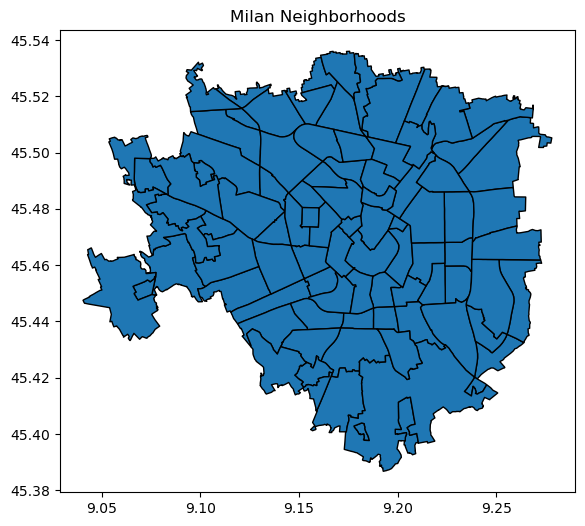

In [4]:
# Plot the map
import matplotlib.pyplot as plt
gdf.plot(figsize=(7, 6), edgecolor='black')
plt.title("Milan Neighborhoods")
plt.show()

# Application: 
## - Topic Modeling and Combining it with GeoJSON data visualization


In [5]:
# data-related tools
import pandas as pd
import geopandas as gpd
import json
import os
from copy import deepcopy
import numpy as np
from tqdm import tqdm
import swifter
import re
# language-related tools
from langdetect import detect, LangDetectException
from google.cloud import translate_v2 as translate
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS
from umap import UMAP
from hdbscan import HDBSCAN
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer
# visualization-related tools
import folium
import matplotlib.pyplot as plt
import seaborn as sns
import base64
from io import BytesIO

In [6]:
#import neighborhood name list 
neighbourhood_name_dir = 'data/neighbourhoods.csv'
neighbourhood_name_list = list(pd.read_csv(neighbourhood_name_dir)['neighbourhood']) # keep it as a list
#import listing data
#here, I would solely focus property id, neighbourhood name, host name, and property location (latitutde & longitude) 
listing_df = pd.read_csv("data/listings.csv")[['id', 'neighbourhood_cleansed','host_name','latitude','longitude']].rename(columns={'id': 'listing_id', 'neighbourhood_cleansed': 'neighbourhood'})
listing_df

,listing_id,neighbourhood,host_name,latitude,longitude
0,6400,TIBALDI,Francesca,45.441190,9.178130
1,304050,XXII MARZO,Elena,45.457090,9.215310
2,23986,NAVIGLI,Jeremy,45.448060,9.173730
3,309905,TICINESE,Elisa,45.443830,9.178600
4,40470,VIALE MONZA,Giacinto,45.520230,9.227470
...,...,...,...,...,...
24341,1183404772778230864,GHISOLFA,Patrick,45.489027,9.158460
24342,1183443016816299488,BUENOS AIRES - VENEZIA,Igor,45.487391,9.212898
24343,1183510554857606594,PARCO SEMPIONE,Olga,45.475590,9.172600
24344,1183852767989216938,PORTA ROMANA,Andrea,45.453714,9.207961


In [7]:
# import reviews with neighborhood names and language labels
# I have already run the comments cleaning, language detection, and translation from another notebook file.
# For the details, please refer to LanguageDetection_Translation.ipynb
reviews_with_neighborhood = pd.read_csv("data/preprocessed_comment_data.csv")
reviews_with_neighborhood

,listing_id,id,date,reviewer_id,reviewer_name,comments,neighbourhood,language,comments_cleaned,translated_comments
0,6400,36772,2010-04-19,94463,Hyun,I had such a great stay at 'the studio.' Franc...,TIBALDI,en,I had such a great stay at 'the studio.' Franc...,I had such a great stay at 'the studio.' Franc...
1,6400,227727,2011-04-16,415910,Tej,Staying at Francesca's and Alberto's place was...,TIBALDI,en,Staying at Francesca's and Alberto's place was...,Staying at Francesca's and Alberto's place was...
2,6400,1162608,2012-04-22,415910,Tej,This is my second time staying with Francesca ...,TIBALDI,en,This is my second time staying with Francesca ...,This is my second time staying with Francesca ...
3,6400,11780336,2014-04-14,5427294,Hatice,"I was lucky so I have stayed with Francesca, A...",TIBALDI,en,"I was lucky so I have stayed with Francesca, A...","I was lucky so I have stayed with Francesca, A..."
4,6400,30074708,2015-04-17,415910,Tej,Always a pleasure staying with Francesca and f...,TIBALDI,en,Always a pleasure staying with Francesca and f...,Always a pleasure staying with Francesca and f...
...,...,...,...,...,...,...,...,...,...,...
826010,1177396299056691638,1183220867919411167,2024-06-20,131662771,Michele,Damiano e Vanessa sono stati gli host migliori...,LORETO,it,Damiano e Vanessa sono stati gli host migliori...,Damiano and Vanessa were the best hosts I&#39;...
826011,1177396299056691638,1183931896768540185,2024-06-21,450184523,Laura,"Vanessa et Damiano était très sympas, nous avo...",LORETO,fr,"Vanessa et Damiano était très sympas, nous avo...","Vanessa and Damiano were very nice, we were ab..."
826012,1178162158561278368,1180348684834926068,2024-06-16,195387166,Simona&Barbara,"Grazioso monolocale curato, situato in una cor...",LORETO,it,"Grazioso monolocale curato, situato in una cor...","Nice and well-kept studio apartment, located i..."
826013,1178253218362535053,1183211946024086802,2024-06-20,9082474,Franck,"Très bel appartement, Idéal pour un séjour à M...",ISOLA,fr,"Très bel appartement, Idéal pour un séjour à M...","Very nice apartment, ideal for a stay in Milan..."


In [8]:
# define a function to clean host name 
def clean_and_split_host_names(name):
    if pd.isnull(name):
        return []

    # Lowercase and strip whitespace
    name = name.lower().strip()

    # Remove common conjunctions and special characters
    name = re.sub(r'\b(e|and|y|et|und)\b', ' ', name)  # different 'and' translations
    name = re.sub(r'[&/,;:+]', ' ', name)              # remove punctuation
    name = re.sub(r'\s+', ' ', name).strip()           # normalize spaces

    # Split by space assuming first names only or name components
    return name.split()

# Apply to the DataFrame
listing_df["host_name_cleaned"] = listing_df["host_name"].apply(clean_and_split_host_names)
listing_df.head()

,listing_id,neighbourhood,host_name,latitude,longitude,host_name_cleaned
0,6400,TIBALDI,Francesca,45.441190,9.178130,[francesca]
1,304050,XXII MARZO,Elena,45.457090,9.215310,[elena]
2,23986,NAVIGLI,Jeremy,45.448060,9.173730,[jeremy]
3,309905,TICINESE,Elisa,45.443830,9.178600,[elisa]
4,40470,VIALE MONZA,Giacinto,45.520230,9.227470,[giacinto]
...,...,...,...,...,...,...
24341,1183404772778230864,GHISOLFA,Patrick,45.489027,9.158460,[patrick]
24342,1183443016816299488,BUENOS AIRES - VENEZIA,Igor,45.487391,9.212898,[igor]
24343,1183510554857606594,PARCO SEMPIONE,Olga,45.475590,9.172600,[olga]
24344,1183852767989216938,PORTA ROMANA,Andrea,45.453714,9.207961,[andrea]


In [9]:
# Combining reviews with property information
reviews_with_neighborhood=pd.merge(reviews_with_neighborhood, listing_df, how='left')
reviews_with_neighborhood.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments,neighbourhood,language,comments_cleaned,translated_comments,host_name,latitude,longitude,host_name_cleaned
0,6400,36772,2010-04-19,94463,Hyun,I had such a great stay at 'the studio.' Franc...,TIBALDI,en,I had such a great stay at 'the studio.' Franc...,I had such a great stay at 'the studio.' Franc...,Francesca,45.441190,9.178130,[francesca]
1,6400,227727,2011-04-16,415910,Tej,Staying at Francesca's and Alberto's place was...,TIBALDI,en,Staying at Francesca's and Alberto's place was...,Staying at Francesca's and Alberto's place was...,Francesca,45.441190,9.178130,[francesca]
2,6400,1162608,2012-04-22,415910,Tej,This is my second time staying with Francesca ...,TIBALDI,en,This is my second time staying with Francesca ...,This is my second time staying with Francesca ...,Francesca,45.441190,9.178130,[francesca]
3,6400,11780336,2014-04-14,5427294,Hatice,"I was lucky so I have stayed with Francesca, A...",TIBALDI,en,"I was lucky so I have stayed with Francesca, A...","I was lucky so I have stayed with Francesca, A...",Francesca,45.441190,9.178130,[francesca]
4,6400,30074708,2015-04-17,415910,Tej,Always a pleasure staying with Francesca and f...,TIBALDI,en,Always a pleasure staying with Francesca and f...,Always a pleasure staying with Francesca and f...,Francesca,45.441190,9.178130,[francesca]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
826010,1177396299056691638,1183220867919411167,2024-06-20,131662771,Michele,Damiano e Vanessa sono stati gli host migliori...,LORETO,it,Damiano e Vanessa sono stati gli host migliori...,Damiano and Vanessa were the best hosts I&#39;...,Damiano,45.492830,9.220920,[damiano]
826011,1177396299056691638,1183931896768540185,2024-06-21,450184523,Laura,"Vanessa et Damiano était très sympas, nous avo...",LORETO,fr,"Vanessa et Damiano était très sympas, nous avo...","Vanessa and Damiano were very nice, we were ab...",Damiano,45.492830,9.220920,[damiano]
826012,1178162158561278368,1180348684834926068,2024-06-16,195387166,Simona&Barbara,"Grazioso monolocale curato, situato in una cor...",LORETO,it,"Grazioso monolocale curato, situato in una cor...","Nice and well-kept studio apartment, located i...",Claudia,45.492790,9.227190,[claudia]
826013,1178253218362535053,1183211946024086802,2024-06-20,9082474,Franck,"Très bel appartement, Idéal pour un séjour à M...",ISOLA,fr,"Très bel appartement, Idéal pour un séjour à M...","Very nice apartment, ideal for a stay in Milan...",Lodovico,45.488940,9.188150,[lodovico]


In [10]:
def mask_host_names_in_comment(comment, host_names):
    if pd.isnull(comment) or not host_names:
        return comment

    # Normalize comment
    comment = str(comment)

    # Replace each host name (case-insensitive, word-boundary-safe)
    for name in host_names:
        pattern = r'\b' + re.escape(name) + r'\b'
        comment = re.sub(pattern, 'HOST', comment, flags=re.IGNORECASE)

    return comment

# Apply this row-wise across the DataFrame
# Assumes you have `comments` and `host_name_cleaned` columns
reviews_with_neighborhood["comments_masked"] = reviews_with_neighborhood.apply(
    lambda row: mask_host_names_in_comment(row["translated_comments"], row["host_name_cleaned"]),
    axis=1
)
reviews_with_neighborhood

,listing_id,id,date,reviewer_id,reviewer_name,comments,neighbourhood,language,comments_cleaned,translated_comments,host_name,latitude,longitude,host_name_cleaned,comments_masked
0,6400,36772,2010-04-19,94463,Hyun,I had such a great stay at 'the studio.' Franc...,TIBALDI,en,I had such a great stay at 'the studio.' Franc...,I had such a great stay at 'the studio.' Franc...,Francesca,45.441190,9.178130,[francesca],I had such a great stay at 'the studio.' HOST ...
1,6400,227727,2011-04-16,415910,Tej,Staying at Francesca's and Alberto's place was...,TIBALDI,en,Staying at Francesca's and Alberto's place was...,Staying at Francesca's and Alberto's place was...,Francesca,45.441190,9.178130,[francesca],Staying at HOST's and Alberto's place was a pl...
2,6400,1162608,2012-04-22,415910,Tej,This is my second time staying with Francesca ...,TIBALDI,en,This is my second time staying with Francesca ...,This is my second time staying with Francesca ...,Francesca,45.441190,9.178130,[francesca],This is my second time staying with HOST and h...
3,6400,11780336,2014-04-14,5427294,Hatice,"I was lucky so I have stayed with Francesca, A...",TIBALDI,en,"I was lucky so I have stayed with Francesca, A...","I was lucky so I have stayed with Francesca, A...",Francesca,45.441190,9.178130,[francesca],"I was lucky so I have stayed with HOST, Andrea..."
4,6400,30074708,2015-04-17,415910,Tej,Always a pleasure staying with Francesca and f...,TIBALDI,en,Always a pleasure staying with Francesca and f...,Always a pleasure staying with Francesca and f...,Francesca,45.441190,9.178130,[francesca],Always a pleasure staying with HOST and family...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
826010,1177396299056691638,1183220867919411167,2024-06-20,131662771,Michele,Damiano e Vanessa sono stati gli host migliori...,LORETO,it,Damiano e Vanessa sono stati gli host migliori...,Damiano and Vanessa were the best hosts I&#39;...,Damiano,45.492830,9.220920,[damiano],HOST and Vanessa were the best hosts I&#39;ve ...
826011,1177396299056691638,1183931896768540185,2024-06-21,450184523,Laura,"Vanessa et Damiano était très sympas, nous avo...",LORETO,fr,"Vanessa et Damiano était très sympas, nous avo...","Vanessa and Damiano were very nice, we were ab...",Damiano,45.492830,9.220920,[damiano],"Vanessa and HOST were very nice, we were able ..."
826012,1178162158561278368,1180348684834926068,2024-06-16,195387166,Simona&Barbara,"Grazioso monolocale curato, situato in una cor...",LORETO,it,"Grazioso monolocale curato, situato in una cor...","Nice and well-kept studio apartment, located i...",Claudia,45.492790,9.227190,[claudia],"Nice and well-kept studio apartment, located i..."
826013,1178253218362535053,1183211946024086802,2024-06-20,9082474,Franck,"Très bel appartement, Idéal pour un séjour à M...",ISOLA,fr,"Très bel appartement, Idéal pour un séjour à M...","Very nice apartment, ideal for a stay in Milan...",Lodovico,45.488940,9.188150,[lodovico],"Very nice apartment, ideal for a stay in Milan..."


# Model 1. Neighborhood-level topic modeling

- Unit of analysis: **Neighborhood**
- Process will be like...
    1. Concatenate comments per neighborhood
    2. Treat comments per neighborhood as **Document**
    3. Run topic model!

In [11]:
# create a dictionary with keys of neighborhood names and values of all comments on properties in the neighborhood
comment_per_neighborhood_dict = {}
for neighborhood in np.unique(neighbourhood_name_list):
    filtered_df = reviews_with_neighborhood[ reviews_with_neighborhood['neighbourhood'] == neighborhood ]
    comment_per_neighborhood_dict[str(neighborhood)] = list(filtered_df.comments_masked)

In [12]:
# define a function to remove stopwords like "a", "about", "above", "after", "and", "the"...
def remove_stopwords(text):
    return " ".join([
        word for word in text.split()
        if word.lower() not in ENGLISH_STOP_WORDS
    ])

In [13]:
# Create a dictionary like: {"Brera": [list of cleaned English comment A, comment B, ...], "Duomo": ...}
documents_by_neighborhood = {
    k: remove_stopwords(" ".join(str(x) for x in v if pd.notnull(x)))
    for k, v in comment_per_neighborhood_dict.items()
}

docs = list(documents_by_neighborhood.values())       # to feed into BERTopic
neighborhoods = list(documents_by_neighborhood.keys())  # to track topics

In [14]:
# Load BERT model
sentence_model = SentenceTransformer("all-MiniLM-L6-v2")
embeddings = sentence_model.encode(docs, show_progress_bar=True)

# UMAP + HDBSCAN settings (same as Ayan's code)
umap_model = UMAP(n_neighbors=15, n_components=10, metric='cosine')
hdbscan_model = HDBSCAN(min_cluster_size=3)  # maybe smaller

Batches:   0%|          | 0/3 [00:00<?, ?it/s]

In [15]:
# Fit BERTopic
model = BERTopic(
    embedding_model=sentence_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=None, 
    verbose=True
)
topics, probs = model.fit_transform(docs, embeddings)

2025-05-30 12:32:34,346 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
2025-05-30 12:32:37,729 - BERTopic - Dimensionality - Completed ✓
2025-05-30 12:32:37,730 - BERTopic - Cluster - Start clustering the reduced embeddings
2025-05-30 12:32:37,735 - BERTopic - Cluster - Completed ✓
2025-05-30 12:32:37,737 - BERTopic - Representation - Fine-tuning topics using representation models.
2025-05-30 12:32:43,384 - BERTopic - Representation - Completed ✓


In [16]:
# print topic information for inspection
topic_info = model.get_topic_info()
topic_info

,Topic,Count,Name,Representation,Representative_Docs
0,-1,29,-1_host_apartment_great_location,"[host, apartment, great, location, stay, clean...",[apartment centrally located center Milan quit...
1,0,20,0_host_apartment_great_stay,"[host, apartment, great, stay, location, clean...",[LOFT cool. It's located north Milan ex-garage...
2,1,17,1_host_apartment_great_stay,"[host, apartment, great, stay, clean, location...","[HOST's flat nice, modern clean. close bar ent..."
3,2,9,2_host_apartment_great_stay,"[host, apartment, great, stay, clean, nice, pl...","[nice staying HOST house. department big , pea..."
4,3,6,3_host_apartment_clean_stay,"[host, apartment, clean, stay, great, nice, pl...",[stayed Carmen's spare bed roughly half months...
5,4,4,4_host_apartment_great_metro,"[host, apartment, great, metro, stay, clean, l...",[HOST nice host instantly replies forms contac...
6,5,3,5_host_apartment_great_stay,"[host, apartment, great, stay, clean, location...",[HOST family terrific hosts group Milan Design...


## It is ***NOT INFORMATIVE*** at all!

# What can we do for the next step?
- Let's think about the data characteristics again...
    1. comments written by reviewers
    2. each comment talks about the property and host
    3. A property lies in neighborhood.

# THUS, Let's try something else! 

# Model 2. Property-level topic modeling

- Unit of analysis: **Property**
- Process will be like...
    1. Concatenate comments per *PROPERTY*
    2. Treat comments per property as **Document**
    3. Run topic model.
    4. Aggregate the results per **neighborhood**
    5. See the ***DISTRIBUTION of Topics***

### 1. Aggregate comments per property

In [17]:
# create a dictionary with keys of listing ids and values of all comments on the property
comment_per_property_dict = {}
for prop_id in np.unique(list(reviews_with_neighborhood.listing_id)):
    filtered_df = reviews_with_neighborhood[ reviews_with_neighborhood['listing_id'] == prop_id]
    comment_per_property_dict[prop_id] = list(filtered_df.comments_masked)

# A dictionary be like: {"Property ID_1": [list of cleaned, English comments], ...}
documents_by_property = {
    k: remove_stopwords(" ".join(str(x) for x in v if pd.notnull(x)))
    for k, v in comment_per_property_dict.items()
}

docs = list(documents_by_property.values())       # to feed into BERTopic
properties = list(documents_by_property.keys())  # to track topics

In [18]:
properties[:10]

[6400, 23986, 40470, 46536, 59226, 82227, 83335, 84741, 88130, 90830]

In [19]:
len(properties)

20077

### 2. Run Topic Model with Property-Comments

In [20]:
# Load BERT model
#sentence_model = SentenceTransformer("all-MiniLM-L6-v2")
embeddings = sentence_model.encode(docs, show_progress_bar=True)

# UMAP + HDBSCAN settings (same as Ayan's code)
umap_model = UMAP(n_neighbors=15, n_components=10, metric='cosine')
hdbscan_model = HDBSCAN(min_cluster_size=3)  

Batches:   0%|          | 0/628 [00:00<?, ?it/s]

In [21]:
# Fit New BERTopic model
new_model = BERTopic(
    embedding_model=sentence_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=None, 
    verbose=True
)
new_topics, new_probs = new_model.fit_transform(docs, embeddings)

2025-05-30 12:33:56,609 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2025-05-30 12:34:06,911 - BERTopic - Dimensionality - Completed ✓
2025-05-30 12:34:06,912 - BERTopic - Cluster - Start clustering the reduced embeddings
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been us

In [22]:
new_topic_info = new_model.get_topic_info()
new_topic_info

,Topic,Count,Name,Representation,Representative_Docs
0,-1,11954,-1_host_apartment_stay_clean,"[host, apartment, stay, clean, great, place, n...",[HOST friendly extremely helpful. stayed place...
1,0,760,0_navigli_canal_bars_lively,"[navigli, canal, bars, lively, florent, canals...",[HOST HOST excellent hsots. appartment brand n...
2,1,298,1_siro_stadium_san_match,"[siro, stadium, san, match, concert, football,...","[HOST daughters gentle, kind lovely us. apartm..."
3,2,182,2_dirty_shower_work_noise,"[dirty, shower, work, noise, toilet, cleaning,...","[Good location, clean exactly photo. Thank qui..."
4,3,163,3_nicola_osvaldo_breakfast_room,"[nicola, osvaldo, breakfast, room, irina, host...",[HOST wonderfull host. help make stay pleasant...
...,...,...,...,...,...
800,799,3,799_agnes_pricings_jefferson_muille,"[agnes, pricings, jefferson, muille, foglia, f...","[HOST kind person, punctual available. takes c..."
801,800,3,800_corrivo_idays_80_plates,"[corrivo, idays, 80, plates, tall, internal, o...",[greeted HOST gave tour apartment; nice quiet ...
802,801,3,801_alessandro_tram_son_bathrooms,"[alessandro, tram, son, bathrooms, tickets, be...",[Fransesco’s place really clean. location 2 mi...
803,802,3,802_train_dryer_bathrooms_luggage,"[train, dryer, bathrooms, luggage, washer, ele...",[lovely place stay loved surely come Milano go...


In [23]:
# create a new data frame with topic per property
listing_topic_df = pd.DataFrame({'listing_id': properties, 
                                 'topic': new_topics})
# merge it with property location information with neighborhood name and coordinates
listing_topic_df = pd.merge(listing_topic_df, listing_df[['listing_id','neighbourhood','latitude','longitude']], how='left')
listing_topic_df

,listing_id,topic,neighbourhood,latitude,longitude
0,6400,-1,TIBALDI,45.441190,9.178130
1,23986,-1,NAVIGLI,45.448060,9.173730
2,40470,-1,VIALE MONZA,45.520230,9.227470
3,46536,53,VIALE MONZA,45.522760,9.224780
4,59226,-1,CENTRALE,45.482010,9.198090
...,...,...,...,...,...
20072,1178724795174333650,-1,DE ANGELI - MONTE ROSA,45.478923,9.149898
20073,1178766455827126425,0,TICINESE,45.455186,9.175261
20074,1178906785730538723,-1,DUOMO,45.465317,9.199627
20075,1179831044941601132,-1,BUENOS AIRES - VENEZIA,45.485670,9.214560


### 3. Check the topic distribution per neighborhood 

In [24]:
# Step 1: Count topics per neighborhood
topic_counts = listing_topic_df.groupby(["neighbourhood", "topic"]).size().reset_index(name="count")

# Step 2: Normalize to proportions
topic_counts["total"] = topic_counts.groupby("neighbourhood")["count"].transform("sum")
topic_counts["proportion"] = topic_counts["count"] / topic_counts["total"]

# Step 3: Pivot to wide format
topic_distribution_wide = topic_counts.pivot_table(
    index="neighbourhood",
    columns="topic",
    values="proportion",
    fill_value=0
).reset_index()

topic_distribution_wide

topic,neighbourhood,-1,0,1,2,3,4,5,6,7,...,794,795,796,797,798,799,800,801,802,803
0,ADRIANO,0.671053,0.000000,0.000000,0.000000,0.013158,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0
1,AFFORI,0.595000,0.000000,0.000000,0.005000,0.005000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0
2,BAGGIO,0.680851,0.000000,0.042553,0.000000,0.021277,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0
3,BANDE NERE,0.600522,0.010444,0.070496,0.007833,0.015666,0.000000,0.000000,0.007833,0.000000,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0
4,BARONA,0.745098,0.019608,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83,VIALE MONZA,0.662069,0.000000,0.000000,0.013793,0.003448,0.000000,0.003448,0.003448,0.006897,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0
84,VIGENTINA,0.665480,0.021352,0.000000,0.000000,0.003559,0.003559,0.000000,0.007117,0.007117,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0
85,VILLAPIZZONE,0.613636,0.000000,0.025568,0.002841,0.005682,0.000000,0.000000,0.019886,0.000000,...,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0
86,WASHINGTON,0.604972,0.016575,0.005525,0.008287,0.002762,0.000000,0.000000,0.008287,0.005525,...,0.000000,0.0,0.0,0.002762,0.0,0.0,0.0,0.000000,0.0,0.0


In [25]:
# import neighborhood geocode
neighborhood_geocode = gpd.read_file('data/neighbourhoods.geojson')[['neighbourhood','geometry']]
neighborhood_geocode

,neighbourhood,geometry
0,SACCO,"MULTIPOLYGON (((9.12195 45.51602, 9.12163 45.5..."
1,COMASINA,"MULTIPOLYGON (((9.16887 45.52396, 9.16804 45.5..."
2,STEPHENSON,"MULTIPOLYGON (((9.12932 45.50998, 9.12973 45.5..."
3,QT 8,"MULTIPOLYGON (((9.14368 45.48474, 9.14338 45.4..."
4,ORTOMERCATO,"MULTIPOLYGON (((9.23739 45.45588, 9.23731 45.4..."
...,...,...
83,PARCO BOSCO IN CITT,"MULTIPOLYGON (((9.09998 45.48789, 9.10146 45.4..."
84,PORTA ROMANA,"MULTIPOLYGON (((9.21002 45.44739, 9.21018 45.4..."
85,PARCO DEI NAVIGLI,"MULTIPOLYGON (((9.15266 45.4152, 9.152 45.4163..."
86,PAGANO,"MULTIPOLYGON (((9.16506 45.46684, 9.16486 45.4..."


In [26]:
# Merge geometry with topic proportions
milan_topic_map = neighborhood_geocode.merge(
    topic_distribution_wide,
    on="neighbourhood",
    how="left"
)
milan_topic_map

,neighbourhood,geometry,-1,0,1,2,3,4,5,6,...,794,795,796,797,798,799,800,801,802,803
0,SACCO,"MULTIPOLYGON (((9.12195 45.51602, 9.12163 45.5...",1.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
1,COMASINA,"MULTIPOLYGON (((9.16887 45.52396, 9.16804 45.5...",0.695652,0.000000,0.000000,0.000000,0.043478,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
2,STEPHENSON,"MULTIPOLYGON (((9.12932 45.50998, 9.12973 45.5...",0.500000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
3,QT 8,"MULTIPOLYGON (((9.14368 45.48474, 9.14338 45.4...",0.564103,0.000000,0.179487,0.000000,0.025641,0.0,0.0,0.025641,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
4,ORTOMERCATO,"MULTIPOLYGON (((9.23739 45.45588, 9.23731 45.4...",0.764706,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
83,PARCO BOSCO IN CITT,"MULTIPOLYGON (((9.09998 45.48789, 9.10146 45.4...",0.714286,0.000000,0.285714,0.000000,0.000000,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
84,PORTA ROMANA,"MULTIPOLYGON (((9.21002 45.44739, 9.21018 45.4...",0.591981,0.007075,0.000000,0.014151,0.014151,0.0,0.0,0.004717,...,0.0,0.0,0.0,0.0,0.0,0.0,0.002358,0.0,0.0,0.0
85,PARCO DEI NAVIGLI,"MULTIPOLYGON (((9.15266 45.4152, 9.152 45.4163...",0.750000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0
86,PAGANO,"MULTIPOLYGON (((9.16506 45.46684, 9.16486 45.4...",0.645000,0.000000,0.010000,0.005000,0.020000,0.0,0.0,0.005000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0


# Visualize the results on the map!



1. Interactive map of Milan
2. Integrate the map with topic distribution

### 1. Make interactive map of Milan

In [27]:
# Load the raw GeoJSON data
with open("data/neighbourhoods.geojson", "r", encoding="utf-8") as f:
    geojson_data = json.load(f)

# Step 1: Create a unique color for each neighborhood
neighborhoods = neighborhood_geocode["neighbourhood"].unique()
palette = sns.color_palette("tab20", len(neighborhoods)).as_hex()  # or use "hls", "Set3", etc.
color_map = dict(zip(neighborhoods, palette))

# Step 2: Build the map
milan_map = folium.Map(location=[45.4642, 9.19], zoom_start=12, tiles="cartodbpositron")

folium.GeoJson(
    data=geojson_data,
    name="Neighborhoods",
    tooltip=folium.GeoJsonTooltip(fields=["neighbourhood"]),
    style_function=lambda feature: {
        "fillColor": color_map.get(feature["properties"]["neighbourhood"], "#cccccc"),
        "color": "black",
        "weight": 1,
        "fillOpacity": 0.4
    }
).add_to(milan_map)

In [28]:
# open the map
milan_map

In [29]:
# Step 3: Add Airbnb listing points
for _, row in listing_df.iterrows():
    folium.CircleMarker(
        location=[row["latitude"], row["longitude"]],
        radius=0.45,
        color="blue",
        fill=True,
        fill_color="blue",
        fill_opacity=0.4,
        popup=folium.Popup(
            f"<b>Listing ID:</b> {row['listing_id']}<br><b>Neighbourhood:</b> {row.get('neighbourhood', 'N/A')}<br><b>Host Name:</b> {row.get('host_name', 'N/A')}",
            max_width=250
        )
    ).add_to(milan_map)

In [30]:
# open the map
milan_map.save("milan_property_map.html")
milan_map

### 2. Visualize the topic distribution on the map

In [31]:
# Mapping: topic number → topic name
topic_label_to_name = dict(zip(new_topic_info["Topic"], new_topic_info["Name"]))

# Get topic columns excluding topic_-1 (e.g., topic_0, topic_1, ...)
topic_cols = [ col for col in topic_distribution_wide.columns if (col != "neighbourhood" and col != -1) ]
#topic_col_labs = [f'topic_{str(t)}' for t in topic_cols]

popup_dict = {}

In [32]:
for _, row in topic_distribution_wide.iterrows():
    neighborhood = row["neighbourhood"]

    # Extract top 5 topics by value
    top_topics = row[topic_cols].sort_values(ascending=False).head(5)

    # Create bar plot
    fig, ax = plt.subplots(figsize=(6, 3))
    x = list(range(len(top_topics)))
    bar_labels = top_topics.index
    bar_values = top_topics.values

    bars = ax.bar(x, bar_values)

    ax.set_title(f"Top 5 Topic Disributions ({neighborhood})")
    ax.set_ylabel("Proportion")
    ax.set_xlabel("Topic Label")
    ax.set_xticks(x)
    ax.set_xticklabels(bar_labels, rotation=45, ha="right")
    ax.set_ylim(0, .6)

    # Add legend mapping topic_label → topic name
    handles = []
    for topic_label in bar_labels:
        topic_num = topic_label
        topic_name = topic_label_to_name.get(topic_num, "")
        handles.append(plt.Rectangle((0, 0), 1, 1, color="lightgray", label=f"{topic_label}: {topic_name}"))
    ax.legend(handles=handles, loc='center left', bbox_to_anchor=(1, 0.5), fontsize="small")

    plt.tight_layout()

    # Convert to base64 image
    buf = BytesIO()
    plt.savefig(buf, format="png", bbox_inches="tight")
    buf.seek(0)
    base64_img = base64.b64encode(buf.read()).decode("utf-8")
    buf.close()
    plt.close(fig)

    html_img = f'<img src="data:image/png;base64,{base64_img}" width="600">'
    popup_dict[neighborhood] = html_img

In [33]:
# Create map
milan_map_topic = folium.Map(location=[45.4642, 9.19], zoom_start=12, tiles="cartodbpositron")

# Add neighborhoods 
for feature in geojson_data["features"]:
    neighborhood = feature["properties"]["neighbourhood"]
    color = color_map.get(neighborhood, "#cccccc")
    popup_html = popup_dict.get(neighborhood, "")

    folium.GeoJson(
        data=feature,
        style_function=lambda feature, color=color: {
            "fillColor": color,
            "color": "black",
            "weight": 1,
            "fillOpacity": 0.4,
        },
        tooltip=folium.GeoJsonTooltip(fields=["neighbourhood"]),
        popup=folium.Popup(folium.IFrame(html=popup_html, width=600, height=350), max_width=700),
    ).add_to(milan_map_topic)

In [34]:
milan_map_topic.save("milan_topic_map.html")
milan_map_topic

## What We Covered Today
- Set up reproducible **Python environments** using `conda` and `.yml` files
- Explored the basics of **geospatial data** and its types
- Loaded and visualized **GeoJSON** files with `geopandas`, `folium`, and `plotly`
- Applied **BERT-based topic modeling** to Airbnb reviews
- Built an **interactive map** with neighborhood-level topic distributions

## Next Steps You Could Try...
- Try adding **temporal dynamics** (e.g., topic changes over time)
- Integrate **demographic or economic data** with neighborhood boundaries
- Explore **streamlit** to deploy your interactive map online

## 💬 Any Questions?
_Ask now — or feel free to reach out later:_ 📧 [minsu.jang@unimib.it](mailto:minsu.jang@unimib.it)